In [1]:
# Import our dependencies
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.metrics import accuracy_score

In [2]:
# matplotlib
%matplotlib inline
import matplotlib
#matplotlib.rcParams.update({'font.size': 4})
matplotlib.rcParams["figure.dpi"] = 125

#set the font for matplotlib
from matplotlib import style
style.use('fivethirtyeight')

from matplotlib import figure
# Pandas and Numpy
import numpy as np
import pandas as pd
import pandas_profiling as pp

# Python SQL toolkit and Object Relational Mapper
import sqlalchemy
from sqlalchemy.ext.automap import automap_base
from sqlalchemy.orm import Session
from sqlalchemy import create_engine, func
import psycopg2

In [3]:
#import connection string (youll need to create this)
from config import conn

# create the engine
engine = create_engine(conn)
Base = automap_base()

# reflect an existing database into a new model
Base.prepare(engine, reflect=True)

# reflect the tables
us_data = Base.classes.us_data_df_v3

In [4]:
# Create our session (link) from Python to the DB
session = Session(engine)

In [5]:
#create df from Recession_Indicator table
results = []

results = session.query(us_data.intdate, \
                        us_data.ri, \
                        us_data.cpi, \
                        us_data.gdp, \
                        us_data.inf, \
                        us_data.unp, \
                        us_data.dji_open, \
                        us_data.dji_open_lag30, \
                        us_data.dji_open_lag90, \
                        us_data.dji_open_lag365, \
                        us_data.dji_close, \
                        us_data.dji_close_lag30, \
                        us_data.dji_close_lag90, \
                        us_data.dji_close_lag365, \
                        us_data.dji_high, \
                        us_data.dji_high_lag30, \
                        us_data.dji_high_lag90, \
                        us_data.dji_high_lag365, \
                        us_data.dji_low, \
                        us_data.dji_low_lag30, \
                        us_data.dji_low_lag90, \
                        us_data.dji_low_lag365, \
                       )

data_df = pd.DataFrame(results)
data_df.head()

,intdate,ri,cpi,gdp,inf,unp,dji_open,dji_open_lag30,dji_open_lag90,dji_open_lag365,...,dji_close_lag90,dji_close_lag365,dji_high,dji_high_lag30,dji_high_lag90,dji_high_lag365,dji_low,dji_low_lag30,dji_low_lag90,dji_low_lag365
0,19701231,False,16.792044,NaN,5.838255,NaN,838.92000000,None,None,None,...,None,None,838.92000000,None,None,None,838.92000000,None,None,None
1,19710104,False,16.834236,1135.156,4.292767,5.994841,830.57000000,None,None,None,...,None,None,830.57000000,None,None,None,830.57000000,None,None,None
2,19710105,False,16.834236,1135.156,4.292767,5.997475,835.77000000,None,None,None,...,None,None,835.77000000,None,None,None,835.77000000,None,None,None
3,19710106,False,16.834236,1135.156,4.292767,6.007436,837.97000000,None,None,None,...,None,None,837.97000000,None,None,None,837.97000000,None,None,None
4,19710107,False,16.834236,1135.156,4.292767,6.121167,837.83000000,None,None,None,...,None,None,837.83000000,None,None,None,837.83000000,None,None,None


In [6]:
# convert to float
data_df[['dji_open', \
            'dji_open_lag30', \
            'dji_open_lag90', \
            'dji_open_lag365', \
            'dji_close', \
            'dji_close_lag30', \
            'dji_close_lag90', \
            'dji_close_lag365', \
            'dji_high', \
            'dji_high_lag30', \
            'dji_high_lag90', \
            'dji_high_lag365', \
            'dji_low', \
            'dji_low_lag30', \
            'dji_low_lag90', \
            'dji_low_lag365']] \
            =data_df[['dji_open', \
                    'dji_open_lag30', \
                    'dji_open_lag90', \
                    'dji_open_lag365', \
                    'dji_close', \
                    'dji_close_lag30', \
                    'dji_close_lag90', \
                    'dji_close_lag365', \
                    'dji_high', \
                    'dji_high_lag30', \
                    'dji_high_lag90', \
                    'dji_high_lag365', \
                    'dji_low', \
                    'dji_low_lag30', \
                    'dji_low_lag90', \
                    'dji_low_lag365']].astype(float)

data_df = pd.get_dummies(data_df, columns=["ri"])
data_df.head()

,intdate,cpi,gdp,inf,unp,dji_open,dji_open_lag30,dji_open_lag90,dji_open_lag365,dji_close,...,dji_high,dji_high_lag30,dji_high_lag90,dji_high_lag365,dji_low,dji_low_lag30,dji_low_lag90,dji_low_lag365,ri_False,ri_True
0,19701231,16.792044,NaN,5.838255,NaN,838.92,NaN,NaN,NaN,838.92,...,838.92,NaN,NaN,NaN,838.92,NaN,NaN,NaN,1,0
1,19710104,16.834236,1135.156,4.292767,5.994841,830.57,NaN,NaN,NaN,830.57,...,830.57,NaN,NaN,NaN,830.57,NaN,NaN,NaN,1,0
2,19710105,16.834236,1135.156,4.292767,5.997475,835.77,NaN,NaN,NaN,835.77,...,835.77,NaN,NaN,NaN,835.77,NaN,NaN,NaN,1,0
3,19710106,16.834236,1135.156,4.292767,6.007436,837.97,NaN,NaN,NaN,837.97,...,837.97,NaN,NaN,NaN,837.97,NaN,NaN,NaN,1,0
4,19710107,16.834236,1135.156,4.292767,6.121167,837.83,NaN,NaN,NaN,837.83,...,837.83,NaN,NaN,NaN,837.83,NaN,NaN,NaN,1,0


In [7]:
# data preprocessing
#data_df = data_df.dropna()
data_df = data_df.fillna(0)
data_df.head()

,intdate,cpi,gdp,inf,unp,dji_open,dji_open_lag30,dji_open_lag90,dji_open_lag365,dji_close,...,dji_high,dji_high_lag30,dji_high_lag90,dji_high_lag365,dji_low,dji_low_lag30,dji_low_lag90,dji_low_lag365,ri_False,ri_True
0,19701231,16.792044,0.000,5.838255,0.000000,838.92,0.0,0.0,0.0,838.92,...,838.92,0.0,0.0,0.0,838.92,0.0,0.0,0.0,1,0
1,19710104,16.834236,1135.156,4.292767,5.994841,830.57,0.0,0.0,0.0,830.57,...,830.57,0.0,0.0,0.0,830.57,0.0,0.0,0.0,1,0
2,19710105,16.834236,1135.156,4.292767,5.997475,835.77,0.0,0.0,0.0,835.77,...,835.77,0.0,0.0,0.0,835.77,0.0,0.0,0.0,1,0
3,19710106,16.834236,1135.156,4.292767,6.007436,837.97,0.0,0.0,0.0,837.97,...,837.97,0.0,0.0,0.0,837.97,0.0,0.0,0.0,1,0
4,19710107,16.834236,1135.156,4.292767,6.121167,837.83,0.0,0.0,0.0,837.83,...,837.83,0.0,0.0,0.0,837.83,0.0,0.0,0.0,1,0


In [8]:
# drop ri_False and rename ri_True ri
data_df = data_df.drop({"ri_False"}, axis=1).rename(columns={'ri_True':'ri'})

data_df.dtypes

intdate               int64
cpi                 float64
gdp                 float64
inf                 float64
unp                 float64
dji_open            float64
dji_open_lag30      float64
dji_open_lag90      float64
dji_open_lag365     float64
dji_close           float64
dji_close_lag30     float64
dji_close_lag90     float64
dji_close_lag365    float64
dji_high            float64
dji_high_lag30      float64
dji_high_lag90      float64
dji_high_lag365     float64
dji_low             float64
dji_low_lag30       float64
dji_low_lag90       float64
dji_low_lag365      float64
ri                    uint8
dtype: object

## Data Insights

In [9]:
# EDA on Data Table, showing 370 observations and 9 characteristics
data_df.shape

(12399, 22)

In [10]:
# EDA to see label of each column
data_df.columns.values 

array(['intdate', 'cpi', 'gdp', 'inf', 'unp', 'dji_open',
       'dji_open_lag30', 'dji_open_lag90', 'dji_open_lag365', 'dji_close',
       'dji_close_lag30', 'dji_close_lag90', 'dji_close_lag365',
       'dji_high', 'dji_high_lag30', 'dji_high_lag90', 'dji_high_lag365',
       'dji_low', 'dji_low_lag30', 'dji_low_lag90', 'dji_low_lag365',
       'ri'], dtype=object)

In [11]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12399 entries, 0 to 12398
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   intdate           12399 non-null  int64  
 1   cpi               12399 non-null  float64
 2   gdp               12399 non-null  float64
 3   inf               12399 non-null  float64
 4   unp               12399 non-null  float64
 5   dji_open          12399 non-null  float64
 6   dji_open_lag30    12399 non-null  float64
 7   dji_open_lag90    12399 non-null  float64
 8   dji_open_lag365   12399 non-null  float64
 9   dji_close         12399 non-null  float64
 10  dji_close_lag30   12399 non-null  float64
 11  dji_close_lag90   12399 non-null  float64
 12  dji_close_lag365  12399 non-null  float64
 13  dji_high          12399 non-null  float64
 14  dji_high_lag30    12399 non-null  float64
 15  dji_high_lag90    12399 non-null  float64
 16  dji_high_lag365   12399 non-null  float6

- Data has only object values
- No variable column has null or missing values

## Summary Statistics

In [12]:
# EDA on Historical Price Table, beginning with basic statistics
data_df.describe()

,intdate,cpi,gdp,inf,unp,dji_open,dji_open_lag30,dji_open_lag90,dji_open_lag365,dji_close,...,dji_close_lag365,dji_high,dji_high_lag30,dji_high_lag90,dji_high_lag365,dji_low,dji_low_lag30,dji_low_lag90,dji_low_lag365,ri
count,1.239900e+04,12399.000000,12399.000000,12399.000000,12399.000000,12399.000000,12399.000000,12399.000000,12399.000000,12399.000000,...,12399.000000,12399.000000,12399.00000,12399.000000,12399.000000,12399.000000,12399.000000,12399.00000,12399.000000,12399.000000
mean,1.995123e+07,63.291900,2991.331013,3.914089,0.191612,7335.375608,-67.493115,-198.307361,-750.467998,7336.506679,...,-750.368518,7392.158310,-67.79876,-199.065316,-754.240032,7276.952230,-66.962499,-197.42783,-746.180526,0.457053
std,1.418788e+05,27.419089,5451.283110,2.930475,1.114408,6894.321945,458.333365,726.295526,1607.039236,6895.339750,...,1606.297067,6931.764989,441.73643,717.394146,1613.540890,6855.776187,473.595226,736.48566,1601.260033,0.498172
min,1.970123e+07,16.792044,0.000000,-0.355546,0.000000,577.600000,-3184.630000,-4419.170000,-7969.800000,577.600000,...,-7980.660000,577.600000,-2974.39000,-4306.790000,-7994.040000,577.600000,-3208.320000,-4241.75000,-7884.690000,0.000000
25%,1.983041e+07,41.684774,0.000000,2.188027,0.000000,1116.765000,-205.190000,-438.080000,-1625.875000,1116.765000,...,-1628.805000,1127.035000,-204.26000,-436.515000,-1645.460000,1106.465000,-206.105000,-436.03500,-1613.745000,0.000000
50%,1.995071e+07,64.383567,0.000000,3.156842,0.000000,4614.780000,-32.260000,-83.170000,-363.370000,4614.780000,...,-361.850000,4646.130000,-31.03000,-83.620000,-365.920000,4578.510000,-32.780000,-85.34000,-358.010000,0.000000
75%,2.007110e+07,88.953113,3578.848000,4.300535,0.000000,11014.780000,43.160000,45.205000,0.000000,11019.265000,...,0.000000,11153.605000,43.06500,43.755000,0.000000,10897.000000,42.950000,45.41000,0.000000,1.000000
max,2.020023e+07,109.295958,21729.124000,13.549202,11.006776,29440.470000,4291.380000,4165.260000,7232.290000,29551.420000,...,7231.600000,29568.570000,3937.95000,3557.400000,7175.570000,29406.750000,4289.700000,4510.03000,7232.940000,1.000000


### Key Observations
- dataset comprises of 64,708 observations and 4 chracteriestics
- out of which x is dependent variable and the remaining x are independent variables
- Data needs to be redone.  Not capturing mean, Standard deviation etc

In [13]:
# EDA on Historical Price Table continued with pandas-profiling

pp.ProfileReport(data_df)

## EDA Data Visualizations


In [32]:
#copy data_df into X and drop recession indicator
X = data_df.copy()
X = X.drop("ri", axis=1)

X.head()

,intdate,cpi,gdp,inf,unp,dji_open,dji_open_lag30,dji_open_lag90,dji_open_lag365,dji_close,...,dji_close_lag90,dji_close_lag365,dji_high,dji_high_lag30,dji_high_lag90,dji_high_lag365,dji_low,dji_low_lag30,dji_low_lag90,dji_low_lag365
0,19701231,16.792044,0.000,5.838255,0.000000,838.92,0.0,0.0,0.0,838.92,...,0.0,0.0,838.92,0.0,0.0,0.0,838.92,0.0,0.0,0.0
1,19710104,16.834236,1135.156,4.292767,5.994841,830.57,0.0,0.0,0.0,830.57,...,0.0,0.0,830.57,0.0,0.0,0.0,830.57,0.0,0.0,0.0
2,19710105,16.834236,1135.156,4.292767,5.997475,835.77,0.0,0.0,0.0,835.77,...,0.0,0.0,835.77,0.0,0.0,0.0,835.77,0.0,0.0,0.0
3,19710106,16.834236,1135.156,4.292767,6.007436,837.97,0.0,0.0,0.0,837.97,...,0.0,0.0,837.97,0.0,0.0,0.0,837.97,0.0,0.0,0.0
4,19710107,16.834236,1135.156,4.292767,6.121167,837.83,0.0,0.0,0.0,837.83,...,0.0,0.0,837.83,0.0,0.0,0.0,837.83,0.0,0.0,0.0


In [33]:
#copy recesison indicator and convert to data frame
y_cols = data_df["ri"] 

y = pd.DataFrame()

y["ri"] = y_cols
y.head()

,ri
0,0
1,0
2,0
3,0
4,0


In [34]:
y['ri'].value_counts()

0    6732
1    5667
Name: ri, dtype: int64

In [35]:
# Create X_train, X_test, y_train, y_test
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y_cols, random_state=1)

## Logistic Regression

In [36]:
from sklearn.linear_model import LogisticRegression

# Define the logistic regression model
log_classifier = LogisticRegression(solver="lbfgs", max_iter=200)

# Train the model
log_classifier.fit(X_train,y_train)

# Evaluate the model
y_pred = log_classifier.predict(X_test)
print(f" Logistic regression model accuracy: {accuracy_score(y_test,y_pred):.3f}")



 Logistic regression model accuracy: 0.621


In [37]:

from sklearn.metrics import confusion_matrix, classification_report

# Calculating the confusion matrix.
cm = confusion_matrix(y_test, y_pred)

# Create a DataFrame from the confusion matrix.
cm_df = pd.DataFrame(
    cm, index=["Actual 0", "Actual 1"], columns=["Predicted 0", "Predicted 1"])

cm_df

,Predicted 0,Predicted 1
Actual 0,1477,206
Actual 1,969,448


In [38]:
report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.60      0.88      0.72      1683
           1       0.69      0.32      0.43      1417

    accuracy                           0.62      3100
   macro avg       0.64      0.60      0.57      3100
weighted avg       0.64      0.62      0.59      3100



## Random Forest

In [39]:
from sklearn.ensemble import RandomForestClassifier

# Creating a StandardScaler instance.
scaler = StandardScaler()
# Fitting the Standard Scaler with the training data.
X_scaler = scaler.fit(X_train)
# Scaling the data.
X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)

In [40]:
# Create a random forest classifier. (17.8.3)
rf_model = RandomForestClassifier(n_estimators=128, random_state=78, max_depth=4) 

# Fitting the model
rf_model = rf_model.fit(X_train_scaled, y_train)

# Making predictions using the testing data.
predictions = rf_model.predict(X_test_scaled)
#predictions = rf_model.predict(X_train_scaled)

In [41]:
# Calculating the confusion matrix.
cm = confusion_matrix(y_test, predictions)
#cm = confusion_matrix(y_train, predictions)

# Create a DataFrame from the confusion matrix.
cm_df = pd.DataFrame(
    cm, index=["Actual 0", "Actual 1"], columns=["Predicted 0", "Predicted 1"])

cm_df

,Predicted 0,Predicted 1
Actual 0,1614,69
Actual 1,489,928


In [42]:
# Calculating the accuracy score.
acc_score = accuracy_score(y_test, predictions)
#acc_score = accuracy_score(y_train, predictions)

# Displaying results
print("Confusion Matrix")
display(cm_df)
print(f"Accuracy Score : {acc_score}")
print("Classification Report")
print(classification_report(y_test, predictions))
#print(classification_report(y_train, predictions))

Confusion Matrix


,Predicted 0,Predicted 1
Actual 0,1614,69
Actual 1,489,928


Accuracy Score : 0.82
Classification Report
              precision    recall  f1-score   support

           0       0.77      0.96      0.85      1683
           1       0.93      0.65      0.77      1417

    accuracy                           0.82      3100
   macro avg       0.85      0.81      0.81      3100
weighted avg       0.84      0.82      0.81      3100



In [43]:
# Calculate feature importance in the Random Forest model.
importances = rf_model.feature_importances_

# We can sort the features by their importance.
sorted(zip(rf_model.feature_importances_, X.columns), reverse=True)

[(0.2531638473195009, 'inf'),
 (0.13433976888805868, 'intdate'),
 (0.1031444241271965, 'cpi'),
 (0.07625887386919805, 'dji_high'),
 (0.07107987827748025, 'dji_open_lag365'),
 (0.061170885805917743, 'dji_low_lag365'),
 (0.05895256221385666, 'dji_high_lag365'),
 (0.05618803764090627, 'dji_close_lag365'),
 (0.04644573339730473, 'dji_open'),
 (0.04008968447693868, 'dji_low'),
 (0.029911066672876473, 'dji_close'),
 (0.01728911960149286, 'dji_close_lag90'),
 (0.014149948785290948, 'dji_open_lag90'),
 (0.013043900202432698, 'dji_high_lag90'),
 (0.012536760250159167, 'dji_low_lag90'),
 (0.005192419627029253, 'gdp'),
 (0.003928476227320115, 'dji_high_lag30'),
 (0.0012985022414755344, 'dji_open_lag30'),
 (0.0011436034214685146, 'dji_low_lag30'),
 (0.000397430030051512, 'dji_close_lag30'),
 (0.0002750769240444518, 'unp')]

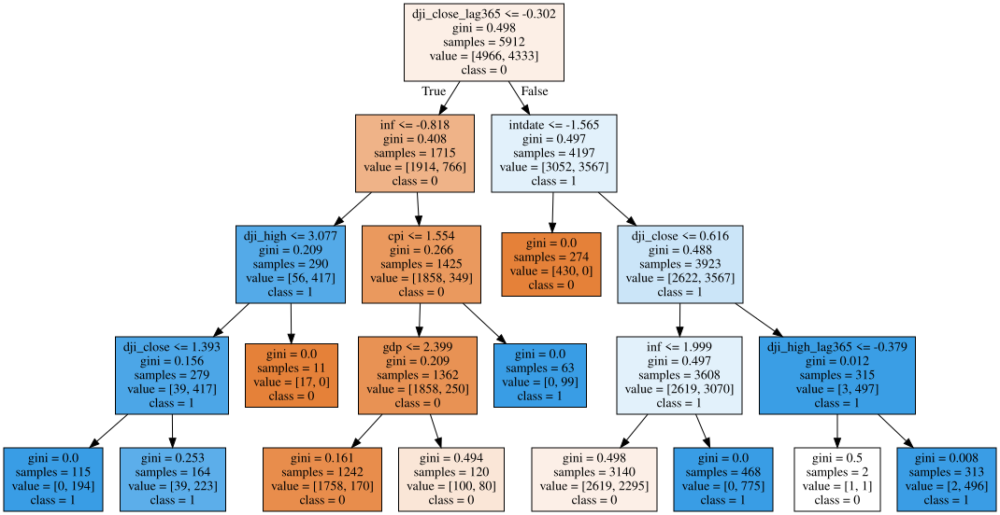

In [44]:
import graphviz
from sklearn import tree
#for tree_in_forest in rf_model.estimators_:
classification_tree = tree.export_graphviz(rf_model.estimators_[0], out_file=None, 
                      feature_names=X.columns,  
                      class_names=["0","1"],  
                      filled=True)
graph = graphviz.Source(classification_tree) 
graph

## Check for missing values

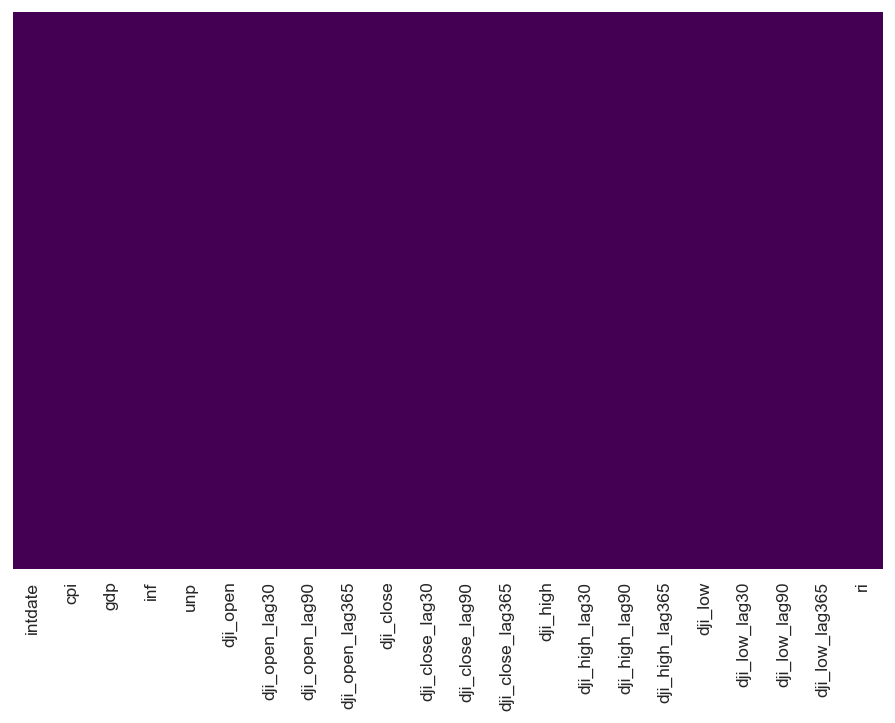

In [45]:
import seaborn as sns
sns.heatmap(data_df.isnull(),cbar=False,yticklabels=False,cmap = 'viridis')

## Checking Correlation

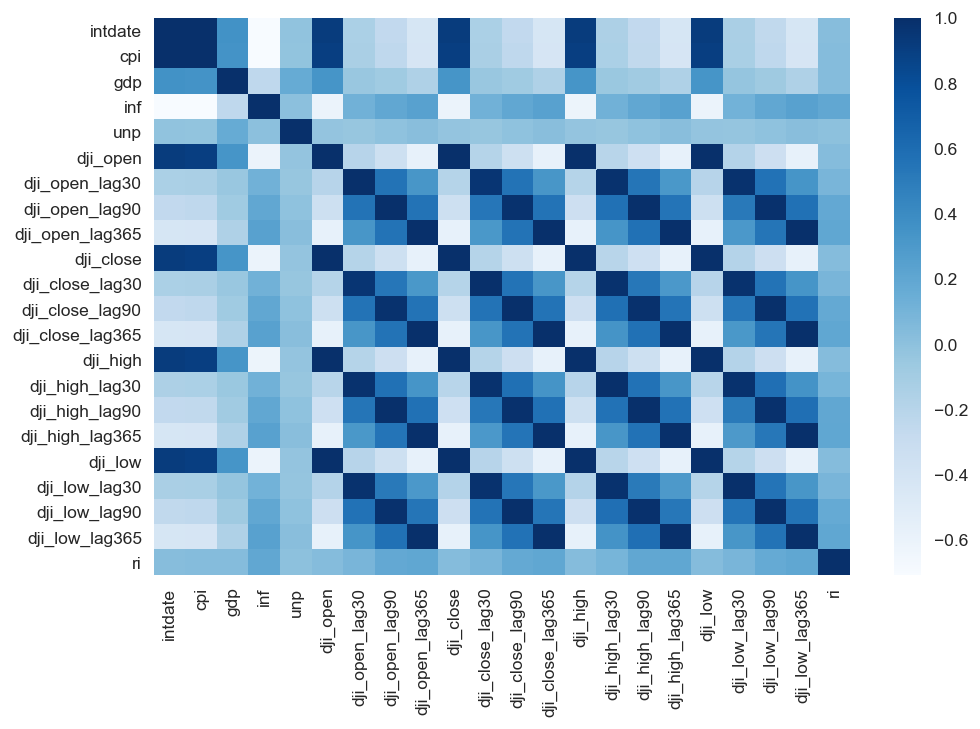

In [46]:
#plt.figure(figsize=(10,10))
figure.Figure(figsize=(10,10))
sns.heatmap(data_df.corr(),cmap='Blues',annot=False)

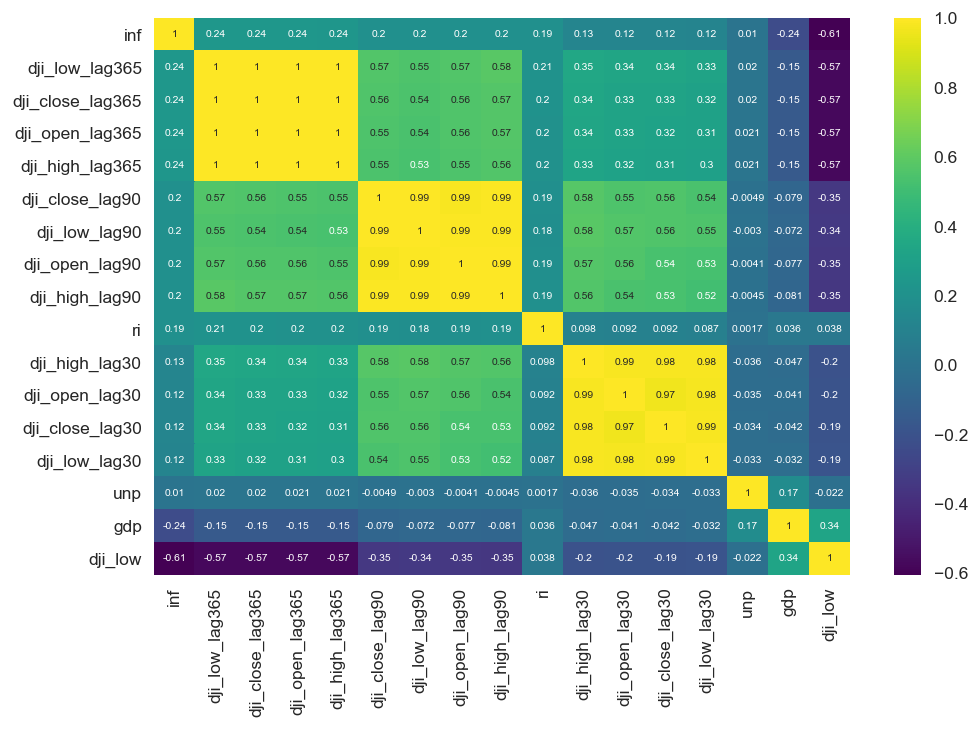

In [47]:
#Quality correlation matrix

matplotlib.rcParams.update({'font.size': 6})

k = 17# number of variables for heatmap
cols = data_df.corr().nlargest(k, 'inf')['inf'].index
cm = data_df[cols].corr()
#plt.figure(figsize=(10,10))
figure.Figure(figsize=(10,100))
sns.heatmap(cm, annot=True, cmap = 'viridis')

## Checking for outliers

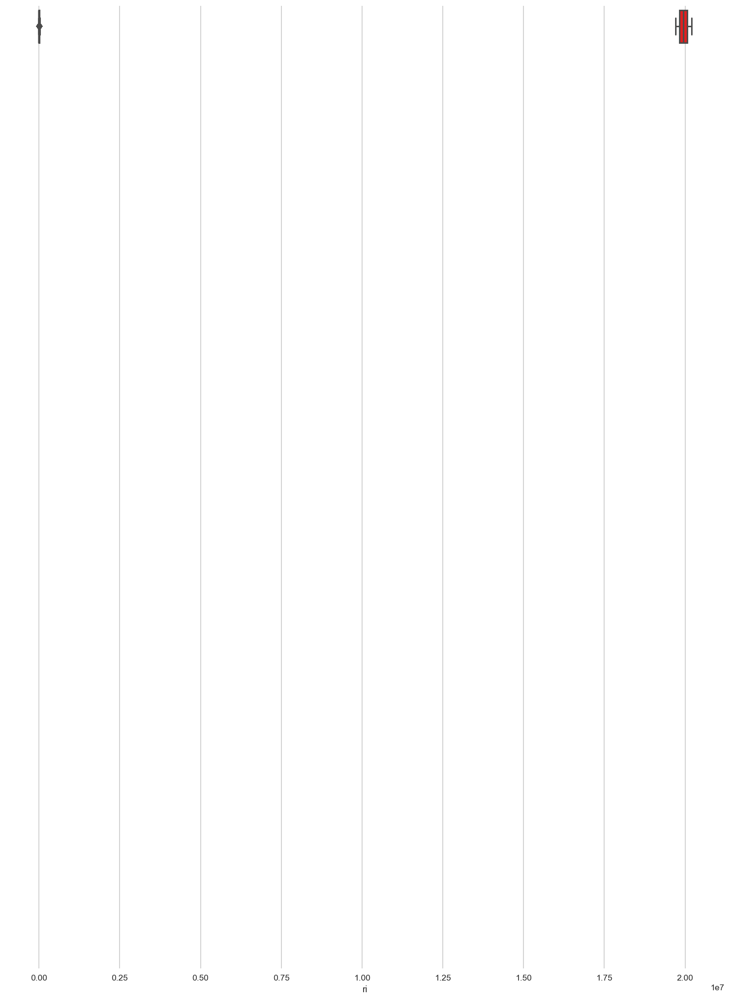

In [48]:
import matplotlib.pyplot as plt

l = data_df.columns.values
number_of_columns=12
number_of_rows = len(l)-1/number_of_columns
plt.figure(figsize=(number_of_columns,.75
                    *number_of_rows))
for i in range(0,len(l)):
    plt.plot(number_of_rows + 1,number_of_columns,i+1)
    sns.set_style('whitegrid')
    sns.boxplot(data_df[l[i]],color='red',orient='h')
    plt.tight_layout()

## Checking skewness

/Users/rfcelorio/anaconda3/envs/mlenv/lib/python3.7/site-packages/seaborn/distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)


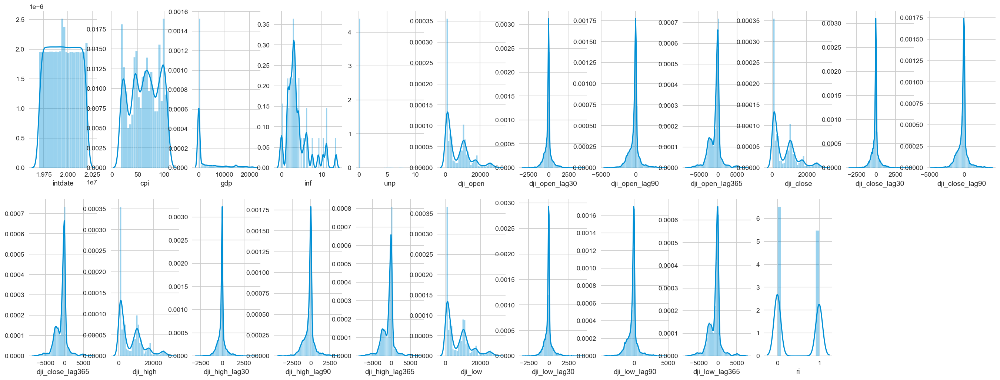

In [49]:
plt.figure(figsize=(2*number_of_columns,5*number_of_rows))
for i in range(0,len(l)):
    plt.subplot(number_of_rows + 1,number_of_columns,i+1)
    sns.distplot(data_df[l[i]],kde=True) 